In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from pathlib import Path
import json
import gc
import random
import warnings
from tqdm.notebook import tqdm
from PIL import Image
import os
from glob import glob
from joblib import Parallel, delayed
import shutil as sh
from itertools import product
from collections import OrderedDict

import torchvision.transforms as transforms
import albumentations as al
from albumentations import ImageOnlyTransform
from albumentations.pytorch import ToTensorV2, ToTensor
from albumentations.core.transforms_interface import DualTransform, ImageOnlyTransform
from iterstrat.ml_stratifiers import MultilabelStratifiedKFold
import cv2
from IPython.display import display, Image
from sklearn.model_selection import train_test_split, KFold, GroupKFold, StratifiedKFold
import torch
from torch.nn import functional as f
import torch.nn as nn
from torch.optim import Adam
from torch.optim.lr_scheduler import StepLR, ReduceLROnPlateau, CosineAnnealingLR
from torch.utils.data import Dataset, DataLoader, sampler

from timm.optim import create_optimizer
from timm.scheduler import create_scheduler

import effdet
from effdet import get_efficientdet_config, EfficientDet, DetBenchTrain, DetBenchPredict
from effdet.efficientdet import HeadNet
from ensemble_boxes import weighted_boxes_fusion, nms

try:
    from apex import amp
    from apex.parallel import DistributedDataParallel as ApexDDP
    from apex.parallel import convert_syncbn_model
    has_apex = True
except ImportError:
    has_apex = False

pd.options.display.max_columns = None
warnings.filterwarnings('ignore')

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(device)

cuda


# Config

In [2]:
SUB_PATH = './public_sample_submission.json'
TRAIN_PATH = './za_traffic_2020/traffic_train/'
TEST_PATH = './za_traffic_2020/traffic_public_test/'
TRAIN_CSV = os.path.join(TRAIN_PATH, 'train_traffic_sign_dataset.json')
TRAIN_IMAGE = os.path.join(TRAIN_PATH, 'images')
TEST_IMAGE = 'data/'

SEED = 89
FOLD_NUM = 10
TRAIN_SIZE = 1024
PADTH_RATIO = 0.1
MOSAIC_RATIO = 0.4
ACCULATION = 1
USE_APEX = True
MODEL_USE = 'd2'
OUTPUT_PATH = 'weight/'
ORG_SIZE = [626, 1622]

class GlobalConfig:
    num_workers = 12
    batch_size = 1
    n_epochs = 20
    lr = 1e-2
    verbose = 1
    verbose_step = 1
    step_scheduler = False  # do scheduler.step after optimizer.step
    validation_scheduler = True  # do scheduler.step after validation stage loss
    SchedulerClass = torch.optim.lr_scheduler.ReduceLROnPlateau
    scheduler_params = dict(
        mode='min', 
        factor=0.2,
        patience=1,
        threshold_mode='abs',
        min_lr=1e-7
    )
    
class PredictConfig:
    SCORE_THRESH = 0.15
    IOU_THRESH = 0.01
    SKIP_THRESH = 0.025
    SCORE_LAST = 0.185
    IOU_THRESH2=0.15

# Function

In [3]:
class NpEncoder(json.JSONEncoder):
    def default(self, obj):
        if isinstance(obj, np.integer):
            return int(obj)
        elif isinstance(obj, np.floating):
            return float(obj)
        elif isinstance(obj, np.ndarray):
            return obj.tolist()
        else:
            return super(NpEncoder, self).default(obj)

        
        
def save_json(pred, json_file):
    with open(json_file, 'w+') as f:
        f.write(json.dumps(pred, cls=NpEncoder, indent=4))
        

        
def read_json(json_file):
    with open(json_file, 'r+') as f:
        content = json.load(f)
    return content



def list_color():
    class_unique = sorted(categorie_df['id'].unique().tolist())
    dict_color = dict()
    for classid in class_unique:
        dict_color[classid] = random.sample(range(256), 3)
    
    return dict_color



def label_resize(org_size, img_size, bbox):
    x, y, w, h = bbox
    x_new = (x*img_size[1]/org_size[1])
    y_new = (y*img_size[0]/org_size[0])
    w_new = (w*img_size[1]/org_size[1])
    h_new = (h*img_size[0]/org_size[0])
    return x_new, y_new, w_new, h_new
    
    
    
def display_image(df, image_df, train_img, test_img, num_image=3):
    all_image = train_img + test_img
    dict_color = list_color()
    
    for img_id in image_df['id']:
        fig, ax = plt.subplots(figsize=(20, 20))
        img_df = df[df['image_id']==img_id].reset_index(drop=True)
        img_path = [i for i in all_image if f'/{img_id}.png' in i][0]
        img = cv2.imread(img_path, cv2.IMREAD_COLOR)
        org_size = img.shape[:2]
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB).astype(np.float32)
        img /= 255.0
        for bbox, category, id_ in zip(img_df['bbox'], img_df['category_id'], img_df['id']):
            x, y, w, h = bbox
            cv2.rectangle(img, (x, y), (x+w, y+h), dict_color[category], 2)
            cv2.putText(img, str(category), (x, y),
                        cv2.FONT_HERSHEY_SIMPLEX,
                        0.75, (0,0,0), 2)
        ax.set_title(f'{img_id}.png have {len(img_df)} bbox')
        ax.imshow(img)
           
    plt.tight_layout()
    plt.show() 
    
    
    
class BaseWheatTTA:
    """ author: @shonenkov """
    image_size = TRAIN_SIZE

    def augment(self, image):
        raise NotImplementedError
    
    def batch_augment(self, images):
        raise NotImplementedError
    
    def deaugment_boxes(self, boxes):
        raise NotImplementedError

class TTAHorizontalFlip(BaseWheatTTA):
    """ author: @shonenkov """

    def augment(self, image):
        return image.flip(1)
    
    def batch_augment(self, images):
        return images.flip(2)
    
    def deaugment_boxes(self, boxes):
        boxes[:, [1,3]] = self.image_size - boxes[:, [3,1]]
        return boxes

class TTAVerticalFlip(BaseWheatTTA):
    """ author: @shonenkov """
    
    def augment(self, image):
        return image.flip(2)
    
    def batch_augment(self, images):
        return images.flip(3)
    
    def deaugment_boxes(self, boxes):
        boxes[:, [0,2]] = self.image_size - boxes[:, [2,0]]
        return boxes
    
class TTARotate90(BaseWheatTTA):
    """ author: @shonenkov """
    
    def augment(self, image):
        return torch.rot90(image, 1, (1, 2))

    def batch_augment(self, images):
        return torch.rot90(images, 1, (2, 3))
    
    def deaugment_boxes(self, boxes):
        res_boxes = boxes.copy()
        res_boxes[:, [0,2]] = self.image_size - boxes[:, [1,3]]
        res_boxes[:, [1,3]] = boxes[:, [2,0]]
        return res_boxes

class TTACompose(BaseWheatTTA):
    """ author: @shonenkov """
    def __init__(self, transforms):
        self.transforms = transforms
        
    def augment(self, image):
        for transform in self.transforms:
            image = transform.augment(image)
        return image
    
    def batch_augment(self, images):
        for transform in self.transforms:
            images = transform.batch_augment(images)
        return images
    
    def prepare_boxes(self, boxes):
        result_boxes = boxes.copy()
        result_boxes[:,0] = np.min(boxes[:, [0,2]], axis=1)
        result_boxes[:,2] = np.max(boxes[:, [0,2]], axis=1)
        result_boxes[:,1] = np.min(boxes[:, [1,3]], axis=1)
        result_boxes[:,3] = np.max(boxes[:, [1,3]], axis=1)
        return result_boxes
    
    def deaugment_boxes(self, boxes):
        for transform in self.transforms[::-1]:
            boxes = transform.deaugment_boxes(boxes)
        return self.prepare_boxes(boxes)
    
    
def display_output(df, json, folder, is_random=True, num_image=1):
    dict_color = list_color()
    if is_random:
        list_image = np.random.choice(df['image_id'].unique(), num_image)
    else:
        list_image = df.loc[:num_image-1, 'image_id'].values
    for img in list_image:
        fig, ax = plt.subplots(figsize=(18, 20))
        image_path = os.path.join(folder, f'{img}.png')
        images = cv2.imread(image_path)
        images = cv2.cvtColor(images, cv2.COLOR_BGR2RGB)
        list_pred = [i for i in json if i['image_id']==img]
        for pred in list_pred:
            score = pred['score']
            box = pred['bbox']
            category = pred['category_id']
            x, y, w, h = list(map(int, box))
            cv2.rectangle(images, (x, y), (x+w, y+h), dict_color[category], 2)
            cv2.putText(images, f'{category}: {score:.2f}', (x, y),
                        cv2.FONT_HERSHEY_SIMPLEX,
                        0.75, (0,0,0), 2)
        ax.set_title(f'{img}.png has {len(list_pred)} box', color='w', fontsize=18)
        ax.imshow(images)
        
        
def bb_intersection_over_union(A, B):
    xA = max(A[0], B[0])
    yA = max(A[1], B[1])
    xB = min(A[2], B[2])
    yB = min(A[3], B[3])

    # compute the area of intersection rectangle
    interArea = max(0, xB - xA) * max(0, yB - yA)

    if interArea == 0:
        return 0.0

    # compute the area of both the prediction and ground-truth rectangles
    boxAArea = (A[2] - A[0]) * (A[3] - A[1])
    boxBArea = (B[2] - B[0]) * (B[3] - B[1])

    iou = interArea / float(boxAArea + boxBArea - interArea)
    return iou

# Read image

In [4]:
sub_df = pd.read_json(SUB_PATH)
sub_df.tail()

,image_id,category_id,bbox,score
0,0,2,"[1135.73, 283.99, 58.88, 55.51]",0.839
1,0,6,"[436.94, 322.41, 8.18, 7.32]",0.198
2,0,7,"[848.99, 299.92, 8.73, 8.41]",0.183
3,0,2,"[848.99, 299.92, 8.73, 8.41]",0.151
4,0,5,"[866.19, 320.02, 8.07, 7.78]",0.121


In [5]:
with open(TRAIN_CSV, 'r') as f:
     train_json = json.loads(f.read())
        
train_json.keys()

dict_keys(['info', 'images', 'annotations', 'categories'])

In [6]:
train_image_df = pd.DataFrame.from_records(train_json['images'])
heigh_width_unique = list(set(zip(*map(train_image_df.get, ['height', 'width']))))
print(heigh_width_unique)
train_image_df.tail()

[(626, 1622)]


,file_name,height,width,id,street_id
4495,12503.png,626,1622,12503,49
4496,12509.png,626,1622,12509,45
4497,12519.png,626,1622,12519,45
4498,12521.png,626,1622,12521,49
4499,12523.png,626,1622,12523,53


In [7]:
annot_df = pd.DataFrame.from_records(train_json['annotations'])
annot_df['weight'] = heigh_width_unique[0][1]
annot_df['height'] = heigh_width_unique[0][0]
annot_df['x'] = annot_df['bbox'].apply(lambda x: x[0])
annot_df['y'] = annot_df['bbox'].apply(lambda x: x[1])
annot_df['w'] = annot_df['bbox'].apply(lambda x: x[2])
annot_df['h'] = annot_df['bbox'].apply(lambda x: x[3])
annot_df.head()

,segmentation,area,iscrowd,image_id,bbox,category_id,id,weight,height,x,y,w,h
0,[],342,0,3,"[880, 333, 19, 18]",2,0,1622,626,880,333,19,18
1,[],6889,0,5,"[1069, 355, 83, 83]",3,1,1622,626,1069,355,83,83
2,[],63,0,5,"[768, 480, 9, 7]",2,2,1622,626,768,480,9,7
3,[],255,0,6,"[781, 337, 17, 15]",6,3,1622,626,781,337,17,15
4,[],56,0,16,"[733, 352, 7, 8]",2,4,1622,626,733,352,7,8


In [8]:
categorie_df = pd.DataFrame.from_records(train_json['categories'])
categorie_df

,supercategory,id,name
0,Cấm ngược chiều,1,Cấm ngược chiều
1,Cấm dừng và đỗ,2,Cấm dừng và đỗ
2,Cấm rẽ,3,Cấm rẽ
3,Giới hạn tốc độ,4,Giới hạn tốc độ
4,Cấm còn lại,5,Cấm còn lại
5,Nguy hiểm,6,Nguy hiểm
6,Hiệu lệnh,7,Hiệu lệnh


In [9]:
train_image_path = glob(f'{TRAIN_IMAGE}/*.*')
test_image_path = glob(f'{TEST_IMAGE}/*.*')

print(f'Number of train image: {len(train_image_path)}, test image: {len(test_image_path)}')

Number of train image: 4500, test image: 586


# Visualize some image

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


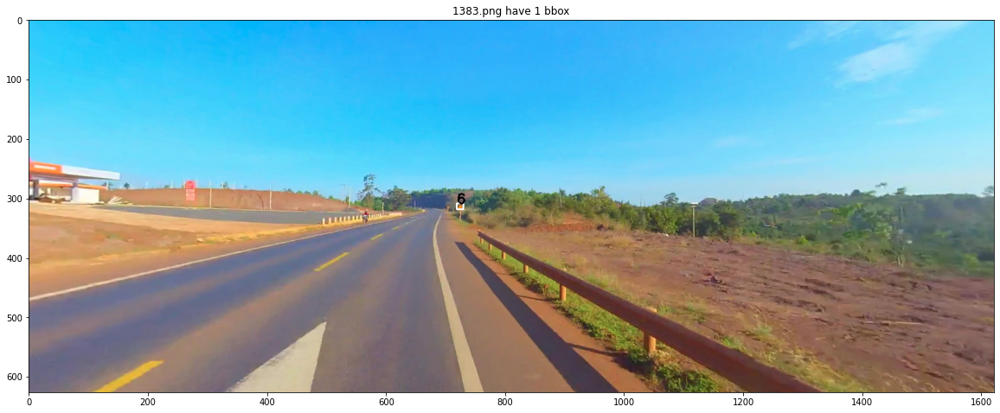

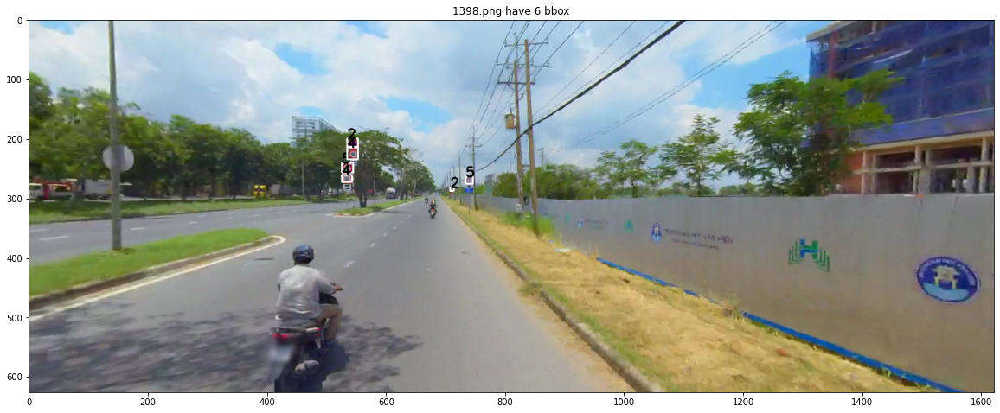

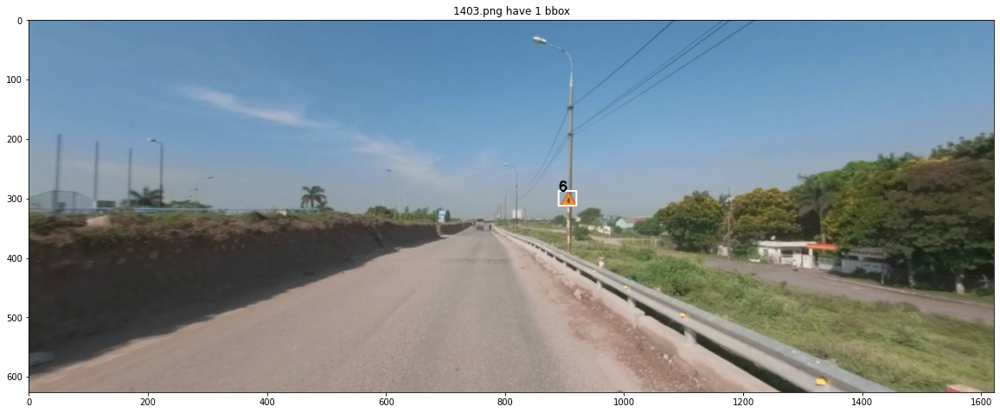

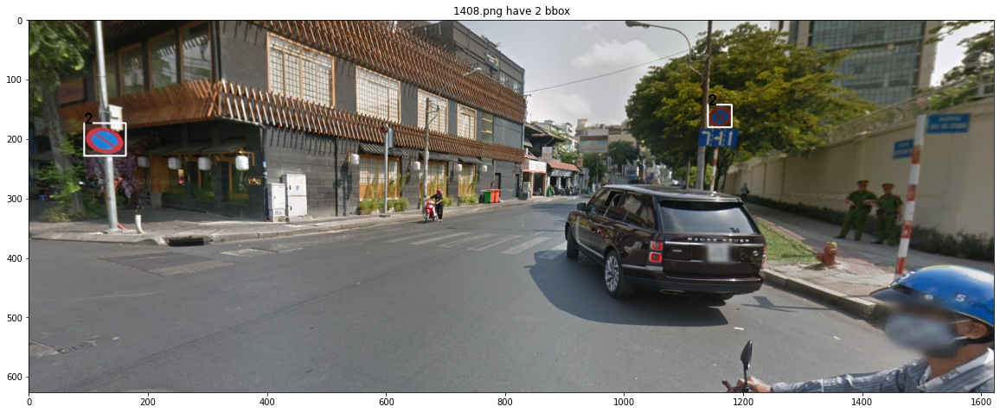

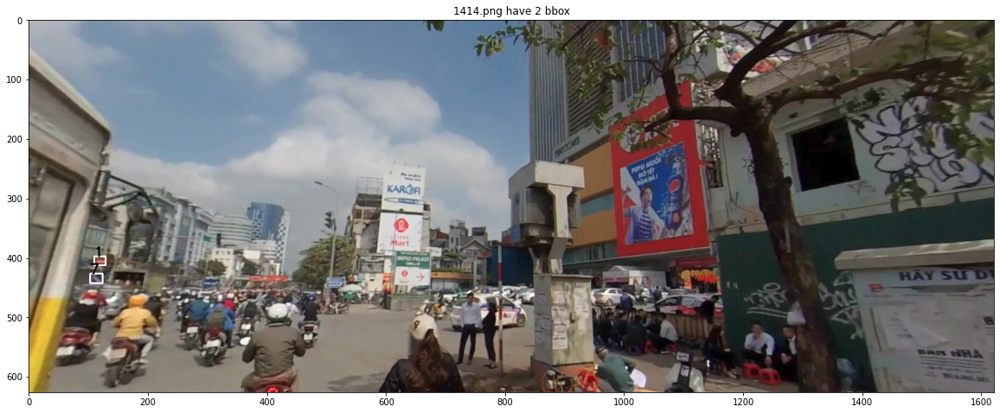

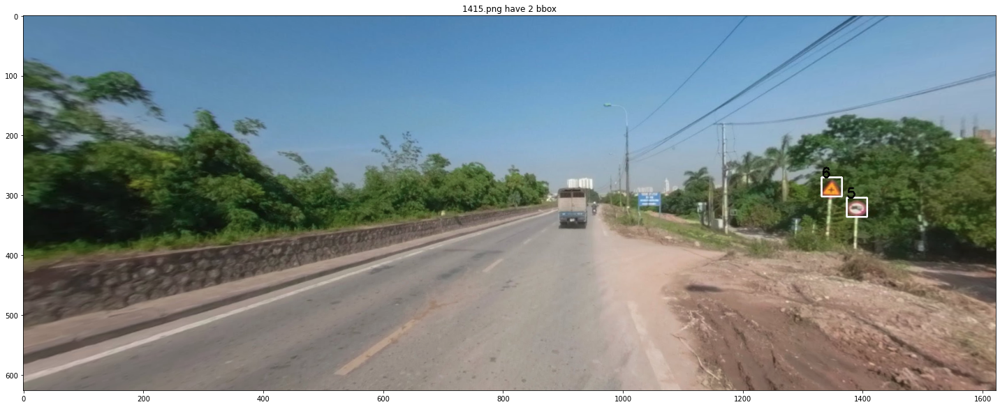

In [10]:
display_image(annot_df, train_image_df[396:402], train_image_path, test_image_path)

# Create data train

In [11]:
def split_df(df):
    kf = MultilabelStratifiedKFold(n_splits=FOLD_NUM, shuffle=True, random_state=SEED)
    annot_pivot = pd.pivot_table(df, index=['image_id'], columns=['category_id'],
                                 values='id', fill_value=0, aggfunc='count') \
    .reset_index().rename_axis(None, axis=1)
    for fold, (train_idx, val_idx) in enumerate(kf.split(annot_pivot,
                                                         annot_pivot.iloc[:, 1:8])):
        annot_pivot[f'fold_{fold}'] = 0
        annot_pivot.loc[val_idx, f'fold_{fold}'] = 1
    return annot_pivot
        
annot_pivot = split_df(annot_df)
annot_pivot.head(10)

,image_id,1,2,3,4,5,6,7,fold_0,fold_1,fold_2,fold_3,fold_4,fold_5,fold_6,fold_7,fold_8,fold_9
0,3,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0
1,5,0,1,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0
2,6,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0
3,16,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0
4,17,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0
5,18,0,2,1,0,1,0,0,0,0,0,0,0,0,0,0,1,0
6,21,0,1,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0
7,22,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0
8,25,0,1,1,0,1,0,0,0,0,0,0,0,1,0,0,0,0
9,28,0,2,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0


# Dataset

In [12]:
class TrafficDataset(Dataset):
    def __init__(self, df, image_path,
                 img_size=(TRAIN_SIZE, TRAIN_SIZE),
                 transform=None, is_train=True):
        super(TrafficDataset, self).__init__()
        self.df = df
        self.image_path = image_path
        self.list_img = list(df['image_id'].unique())
        self.img_size = img_size
        self.is_train = is_train
        self.transform = transform
        
    def __len__(self):
        return len(self.list_img)
    
    def load_image_and_boxes(self, index):
        image_id = self.list_img[index]
        if os.path.exists(f'{self.image_path[0]}/{image_id}.png'):
            image = cv2.imread(f'{self.image_path[0]}/{image_id}.png', cv2.IMREAD_COLOR)
        else:
            image = cv2.imread(f'{self.image_path[1]}/{image_id}.png', cv2.IMREAD_COLOR)
        org_size = image.shape[:2]
        image = cv2.resize(image, self.img_size[::-1], cv2.INTER_AREA)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB).astype(np.float32)
        image /= 255.0
        if self.is_train:
            records = self.df[self.df['image_id'] == image_id]
            boxes = records[['x', 'y', 'w', 'h', 'category_id']].values
            for box_id in range(len(boxes)):
                boxes[box_id, :-1] = label_resize(org_size, self.img_size, boxes[box_id, :-1])
            boxes[:, 2] = boxes[:, 0] + boxes[:, 2]
            boxes[:, 3] = boxes[:, 1] + boxes[:, 3]
            return image, boxes
        else:
            return image, None
    
    def load_cutmix_image_and_boxes(self, index, padth_ratio=PADTH_RATIO):
        s = self.img_size[0]//2
        h, w = self.img_size
        
        xc, yc = [int(random.uniform((0.5-padth_ratio)*self.img_size[0],
                                     (0.5+padth_ratio)*self.img_size[0])) for _ in range(2)]
        indexes = [index] + [random.randint(0, len(self.list_img)-1) for _ in range(3)]
        result_image = np.full((w, h, 3), 1, dtype=np.float32)
        result_boxes = []

        for i, index in enumerate(indexes):
            image, boxes = self.load_image_and_boxes(index)
            if i == 0:  # top left
                x1a, y1a, x2a, y2a = max(xc - w, 0), max(yc - h, 0), xc, yc  # xmin, ymin, xmax, ymax (large image)
                x1b, y1b, x2b, y2b = w - (x2a - x1a), h - (y2a - y1a), w, h  # xmin, ymin, xmax, ymax (small image)
            elif i == 1:  # top right
                x1a, y1a, x2a, y2a = xc, max(yc - h, 0), min(xc + w, s * 2), yc
                x1b, y1b, x2b, y2b = 0, h - (y2a - y1a), min(w, x2a - x1a), h
            elif i == 2:  # bottom left
                x1a, y1a, x2a, y2a = max(xc - w, 0), yc, xc, min(s * 2, yc + h)
                x1b, y1b, x2b, y2b = w - (x2a - x1a), 0, max(xc, w), min(y2a - y1a, h)
            elif i == 3:  # bottom right
                x1a, y1a, x2a, y2a = xc, yc, min(xc + w, s * 2), min(s * 2, yc + h)
                x1b, y1b, x2b, y2b = 0, 0, min(w, x2a - x1a), min(y2a - y1a, h)
            result_image[y1a:y2a, x1a:x2a] = image[y1b:y2b, x1b:x2b]
            # boxes
            padw = x1a - x1b
            padh = y1a - y1b

            boxes[:, 0] += padw
            boxes[:, 1] += padh
            boxes[:, 2] += padw
            boxes[:, 3] += padh
            result_boxes.append(boxes)
        if len(result_boxes) > 0:
            result_boxes = np.concatenate(result_boxes, 0)
            np.clip(result_boxes[:, :-1], 0, 2*s, out=result_boxes[:, :-1])
            result_boxes = result_boxes.astype(np.int32)
            result_boxes = result_boxes[np.where((result_boxes[:,2]-result_boxes[:,0])* \
                                                 (result_boxes[:,3]-result_boxes[:,1]) > 0)]
            
        return result_image, result_boxes
    
    def __getitem__(self, index):
        img_idx = self.list_img[index]
        if not self.is_train or random.random() > MOSAIC_RATIO:
            image, boxes = self.load_image_and_boxes(index)
        else:
            image, boxes = self.load_cutmix_image_and_boxes(index)
        if self.is_train:
            target = {}
            target['boxes'] = boxes[:, :-1]
            target['labels'] = torch.from_numpy(boxes[:, -1])
            target['img_scale'] = torch.tensor([1.])
            target['image_id'] = torch.tensor([index])
            target['img_size'] = torch.tensor([self.img_size])
            if self.transform is not None:
                for i in range(10):
                    sample = {
                        'image': image,
                        'bboxes': target['boxes'],
                        'labels': target['labels']
                    }
                    sample = self.transform(**sample)
                    if len(sample['bboxes']) > 0:
                        image = sample['image']
                        target['boxes'] = torch.stack(tuple(map(torch.tensor,
                                                                zip(*sample['bboxes'])))).permute(1, 0)
                        target['boxes'][:,[0,1,2,3]] = target['boxes'][:,[1,0,3,2]]
                        break
            if type(image) is np.ndarray:
                image = torch.from_numpy(image).permute(2, 0, 1)
            return image, target
        else:
            if self.transform is not None:
                sample = {'image' : image}
                sample = self.transform(**sample)
                image = sample['image']

            img_info = {}
            img_info['img_scale'] = torch.tensor([1.])
            img_info['img_size'] = torch.tensor([self.img_size])
            return image, img_idx, img_info
            
    def collate_fn(self, batch):
        return tuple(zip(*batch))

In [13]:
train_transform = al.Compose([
    al.VerticalFlip(p=0.5),
    al.HorizontalFlip(p=0.5),
    al.RandomGamma(gamma_limit=(50, 150), p=0.5),
#     al.Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225), p=1),
    ToTensorV2(p=1)
], bbox_params = {'format': 'pascal_voc', 'label_fields': ['labels']})


val_transform = al.Compose([
#     al.Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225), p=1),
    ToTensorV2(p=1)
], bbox_params = {'format': 'pascal_voc', 'label_fields': ['labels']})


test_transform = al.Compose([
#     al.Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225), p=1),
    ToTensorV2(p=1)
], p=1)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


17038

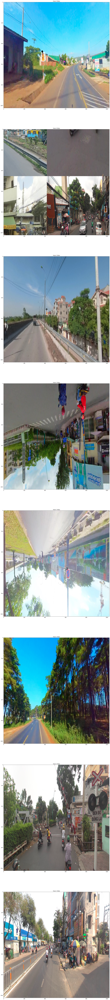

In [14]:
img_train = annot_pivot[annot_pivot['fold_0']==0]['image_id'].tolist()
train_ex = annot_df[annot_df['image_id'].isin(img_train)].reset_index(drop=True)
dataset = TrafficDataset(train_ex, [TRAIN_IMAGE, TEST_IMAGE],
                         transform=train_transform, is_train=True)
dl = DataLoader(dataset, batch_size=8, shuffle=True, collate_fn=dataset.collate_fn)
images, bboxes = next(iter(dl))
dict_color = list_color()
fig = plt.figure(figsize=(200, 200))
for ii, (im, boxes) in enumerate(zip(images, bboxes)):
    im = im.permute(1, 2, 0).cpu().detach().numpy()
    ax = fig.add_subplot(8, 1, ii+1)
    if len(boxes['boxes']) > 0:
        for box, category in zip(boxes['boxes'], boxes['labels']):
            y0, x0, y1, x1 = [int(i) for i in box.detach().cpu().numpy()]
            cv2.rectangle(im, (x0, y0), (x1, y1), dict_color[category.item()], 2)
            cv2.putText(im, str(category.item()), (x0, y0),
                            cv2.FONT_HERSHEY_SIMPLEX,
                            0.75, (0,0,0), 2)
    ax.set_title(f"Have {len(boxes['boxes'])} bbox")
    plt.imshow(im)
    
del dataset, dl, train_ex, bboxes, images, img_train
gc.collect()

# Model

In [15]:
class EfficientDetCus(nn.Module):
    
    def __init__(self, model=MODEL_USE, num_class=len(categorie_df)):
        super(EfficientDetCus, self).__init__()
        
        config = get_efficientdet_config(f'tf_efficientdet_{model}')
        config.num_classes = num_class
        config.image_size = [TRAIN_SIZE, TRAIN_SIZE]
        model = EfficientDet(config=config, pretrained_backbone=False)
        model.class_net = HeadNet(config, num_outputs=config.num_classes)
        self.model = DetBenchTrain(model, config)
        
    def forward(self, image, target):
        out = self.model(image, target)
        return out

# Engineer

In [16]:
class AverageMeter():
    def __init__(self):
        self.reset()
    
    def reset(self):
        self.val = 0
        self.avg = 0
        self.sum = 0
        self.count = 0
        
    def update(self, val, n=1):
        self.val = val
        self.sum += val * n
        self.count += n
        self.avg = self.sum / self.count
        
        

def train_lf(train_loader, model, optimizer, scheduler, config,
             device=device, accumulation_step=ACCULATION):
    model.train()
    summary_loss = AverageMeter()
    for idx, (images, targets) in tqdm(enumerate(train_loader),
                                       total=len(train_loader),
                                       leave=False):
        target_res = {}
        images = torch.stack(images)
        images = images.to(device).float()
        
        boxes = [torch.from_numpy(target['boxes']).to(device).float() \
                 if type(target['boxes']) is np.ndarray \
                 else target['boxes'].to(device).float() \
                 for target in targets]
        labels = [target['labels'].to(device).float() for target in targets]
        target_res["img_scale"] = torch.tensor([1.0] * config.batch_size,
                                               dtype=torch.float).to(device)
        target_res["img_size"] = torch.tensor([images[0].shape[-2:]] \
                                              * config.batch_size,
                                              dtype=torch.float).to(device)
        target_res['bbox'] = boxes
        target_res['cls'] = labels
        optimizer.zero_grad()
        outputs = model(images, target_res)
        loss = outputs['loss']
        loss.backward()
        if idx % accumulation_step == 0:
            optimizer.step()
            optimizer.zero_grad()
        torch.cuda.synchronize()
        summary_loss.update(loss.detach().item(), images.shape[0])

    return summary_loss.avg


def val_lf(valid_loader, model, config):
    model.eval()
    summary_loss = AverageMeter()
    for steps, (images, targets) in tqdm(enumerate(valid_loader),
                                         total=len(valid_loader),
                                         leave=False):
        with torch.no_grad():
            pred_res = {}
            images = torch.stack(images)
            images = images.to(device).float()

            boxes = [torch.from_numpy(target['boxes']).to(device).float() \
                     if type(target['boxes']) is np.ndarray \
                     else target['boxes'].to(device).float() \
                     for target in targets]
            labels = [target['labels'].to(device).float() for target in targets]
            pred_res["img_scale"] = torch.tensor([1.0] * config.batch_size,
                                                 dtype=torch.float).to(device)
            pred_res["img_size"] = torch.tensor([images[0].shape[-2:]] \
                                                * config.batch_size,
                                                dtype=torch.float).to(device)
            pred_res['bbox'] = boxes
            pred_res['cls'] = labels
            
            outputs = model(images, pred_res)
            loss = outputs['loss']
            
            torch.cuda.synchronize()
            summary_loss.update(loss.detach().item(), images.shape[0])

    return summary_loss.avg

# Train process

In [17]:
class Train_process(object):
    def __init__(self, device=device, config=GlobalConfig):
        super(Train_process, self).__init__()
        self.config = config
        self.device = device
    def process_data(self, train_df, split_df, fold_idx):
        img_train = split_df[split_df[f'fold_{fold_idx}']==0]['image_id'].tolist()
        train_data = train_df[train_df['image_id'].isin(img_train)].reset_index(drop=True)
        val_data = train_df[~train_df['image_id'].isin(img_train)].reset_index(drop=True)
        # Create dataset
        train_dataset = TrafficDataset(train_data, [TRAIN_IMAGE, TEST_IMAGE],
                                       transform=train_transform, is_train=True)
        valid_dataset = TrafficDataset(val_data, [TRAIN_IMAGE, TEST_IMAGE],
                                       transform=val_transform, is_train=True)
        # Create dataloader
        train_loader = DataLoader(train_dataset,
                                  batch_size = self.config.batch_size,
                                  collate_fn = train_dataset.collate_fn,
                                  shuffle=True, pin_memory=True,
                                  num_workers=self.config.num_workers)
        valid_loader = DataLoader(valid_dataset, pin_memory=True,
                                  batch_size = self.config.batch_size,
                                  collate_fn = valid_dataset.collate_fn,
                                  num_workers=self.config.num_workers)
        
        del img_train, train_data, val_data, train_dataset, valid_dataset
        gc.collect()
        return train_loader, valid_loader
    
    def fit(self, train_df, split_df):
        if torch.cuda.is_available():
            torch.backends.cudnn.benchmark= False
        torch.cuda.empty_cache()
        for fold in range(FOLD_NUM//2):
            print(50*'-')
            print(f'Fold{2*fold}:')
            model = EfficientDetCus().to(device)                        
            optimizer = torch.optim.AdamW(model.parameters(), lr = self.config.lr)
            scheduler = self.config.SchedulerClass(optimizer, **self.config.scheduler_params)
            train_loader, valid_loader = self.process_data(train_df, split_df, 2*fold)

            best_val_loss = np.Inf
            for epoch in range(self.config.n_epochs):
                train_loss = train_lf(train_loader, model, optimizer,
                                      scheduler, config=self.config)
                val_loss = val_lf(valid_loader, model, config=self.config)
                print(f'Epoch{epoch}: \tTrain_loss: {train_loss:.5f} | Val_loss: {val_loss:.5f}')

                if best_val_loss > val_loss:
                    best_val_loss = val_loss
                    torch.save(model.state_dict(), f'{OUTPUT_PATH}model_fold{fold}.pth')
                    print('Model improved, saving model!')

                if self.config.validation_scheduler:
                    scheduler.step(val_loss)
            torch.cuda.empty_cache()
            
# train_pr = Train_process()
# train_pr.fit(annot_df, annot_pivot) 

# TTA

In [18]:
tta_transforms = []
for tta_combination in product([TTAHorizontalFlip(), None], 
                               [TTAVerticalFlip(), None]):
    tta_transforms.append(TTACompose([tta_transform \
                                      for tta_transform in tta_combination \
                                      if tta_transform]))

# Model pred

In [19]:
class EfficientDetPred(nn.Module):
    
    def __init__(self, model_weight='weight/model_fold0.pth', num_class=len(categorie_df)):
        super(EfficientDetPred, self).__init__()
        
        config = get_efficientdet_config(f'tf_efficientdet_{MODEL_USE}')
        config.num_classes = num_class
        config.image_size = [TRAIN_SIZE, TRAIN_SIZE]
        model = EfficientDet(config, pretrained_backbone=False)
        model.class_net = HeadNet(config, num_outputs=config.num_classes)
        
        new_keys = model.state_dict().keys()
        values = torch.load(model_weight, map_location=lambda storage, loc: storage).values()
        model.load_state_dict(OrderedDict(zip(new_keys, values)))
        self.model = DetBenchPredict(model)
        
        del new_keys, values
        gc.collect()
    
    def forward(self, image, img_info=None):
        out = self.model(image, img_info)
        return out

In [20]:
list_img_test = sorted([int(i.split('/')[-1][:-4]) for i in test_image_path])
test_df = pd.DataFrame({'image_id': list_img_test})
test_df.head()

,image_id
0,0
1,4
2,11
3,13
4,19


In [21]:
%%time

test_dataset = TrafficDataset(test_df[:20], [TRAIN_IMAGE, TEST_IMAGE],
                              transform=test_transform, is_train=False)
test_ld = DataLoader(test_dataset, batch_size=8, shuffle=False,
                     collate_fn=test_dataset.collate_fn)
print(f'Number of test dataloader: {len(test_ld)}')

Number of test dataloader: 3
CPU times: user 449 µs, sys: 69 µs, total: 518 µs
Wall time: 414 µs


# Predict

In [22]:
def run_wbf(predictions, image_index,
            image_size=TRAIN_SIZE,
            iou_thr=PredictConfig.IOU_THRESH,
            iou_thr2=PredictConfig.IOU_THRESH2,
            skip_box_thr=PredictConfig.SKIP_THRESH,
            weights=None):
    
    boxes = [(prediction[image_index]['boxes']/(image_size-1)).tolist() \
             for prediction in predictions]
    scores = [prediction[image_index]['scores'].tolist() for prediction in predictions]
    labels = [prediction[image_index]['labels'].tolist() for prediction in predictions]
    boxes, scores, labels = weighted_boxes_fusion(boxes, scores, labels,
                                                  weights=weights,
                                                  iou_thr=iou_thr,
                                                  skip_box_thr=skip_box_thr)
    
    new_labels = [1.]*len(labels)
    new_boxes, new_scores, new_labels = weighted_boxes_fusion([boxes], [scores],
                                                              [new_labels],
                                                              weights=weights,
                                                              iou_thr=iou_thr2,
                                                              skip_box_thr=skip_box_thr)
    index_boxes_save = []
    for id_box, new_box in enumerate(new_boxes):
        for box in boxes:
            iou = bb_intersection_over_union(box, new_box)
            if iou > 0.:
                index_boxes_save.append(id_box)
                break
    scores = [scores[i] for i in index_boxes_save]
    labels = [labels[i] for i in index_boxes_save]
    new_boxes = new_boxes*(image_size-1)
    return new_boxes, scores, labels



def predict(images, img_info, score_thres=PredictConfig.SCORE_THRESH):
    list_weight = sorted([i for i in os.listdir(OUTPUT_PATH) if '.pth' in i])
    prediction = []
    for weight in list_weight:
        weight = os.path.join(OUTPUT_PATH, weight)
        net = EfficientDetPred(weight).to(device)
        net.eval()
        with torch.no_grad():
            for tta_transform in tta_transforms:
                result = []
                det = net(tta_transform.batch_augment(images.clone()), img_info=None)
                for i in range(images.shape[0]):
                    boxes = det[i].detach().cpu().numpy()[:,:4]    
                    scores = det[i].detach().cpu().numpy()[:,4]
                    labels = det[i].detach().cpu().numpy()[:,5]
                    indexes = np.where(scores > score_thres)[0]
                    boxes = boxes[indexes]
                    labels = labels[indexes]
                    boxes = tta_transform.deaugment_boxes(boxes.copy())
                    result.append({
                        'labels': labels[indexes],
                        'boxes': boxes,
                        'scores': scores[indexes],
                    })

                prediction.append(result)

    return prediction


def wbf_cal(test_loader):
    all_results = []
    for images, image_ids, img_info in tqdm(test_loader, leave=False,
                                            total=len(test_loader)):
        images = torch.stack(images).to(device).float()
        predictions = predict(images, img_info=None)
        for i, (image, img_id) in enumerate(zip(images, image_ids)):
            boxes, scores, labels = run_wbf(predictions, image_index=i)
            boxes = (boxes*1).round(2).clip(min=0, max=TRAIN_SIZE-1)
            image_id = image_ids[i]

            boxes[:, 2] = boxes[:, 2] - boxes[:, 0]
            boxes[:, 3] = boxes[:, 3] - boxes[:, 1]
            results = []
            for box, score, label in zip(boxes, scores, labels):
                if score > PredictConfig.SCORE_LAST:
                    box = label_resize([TRAIN_SIZE, TRAIN_SIZE], ORG_SIZE, box)
                    result = dict()
                    result["image_id"] = image_id
                    result["category_id"] = int(label)
                    result["bbox"] = [i.round(2) for i in box]
                    result["score"] = score
                    results.append(result)
                else:
                    break
            print(f'{image_id} have {len(results)} bounding box!')
            all_results.extend(results)
    print(50*'-')
    print(f'Total have {len(all_results)} bounding box!')
    return all_results

predictions = wbf_cal(test_ld)
# save_json(predictions, 'submission.json')

0 have 1 bounding box!
4 have 3 bounding box!
11 have 7 bounding box!
13 have 4 bounding box!
19 have 8 bounding box!
23 have 3 bounding box!
30 have 6 bounding box!
39 have 1 bounding box!
43 have 2 bounding box!
46 have 0 bounding box!
48 have 1 bounding box!
52 have 1 bounding box!
53 have 2 bounding box!
54 have 3 bounding box!
64 have 1 bounding box!
71 have 0 bounding box!
75 have 3 bounding box!
80 have 3 bounding box!
83 have 3 bounding box!
84 have 1 bounding box!
--------------------------------------------------
Total have 53 bounding box!


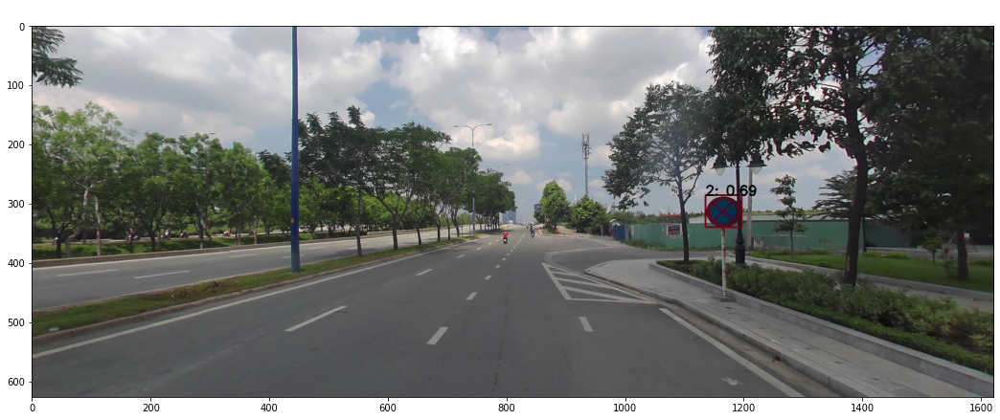

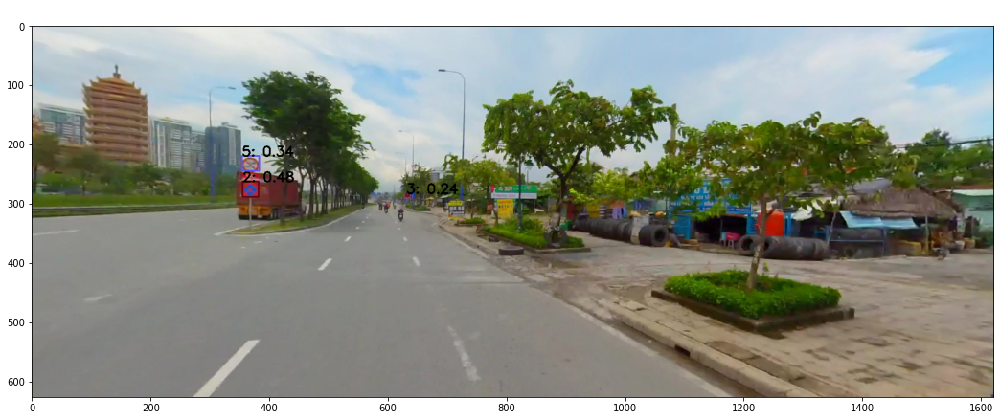

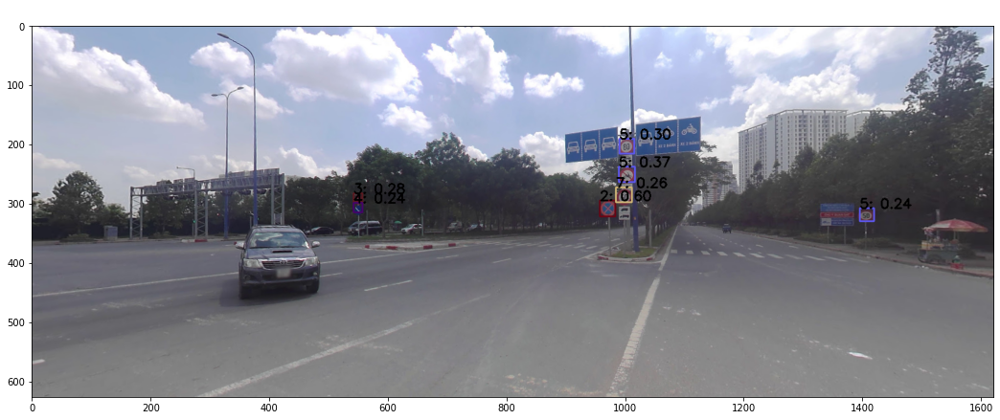

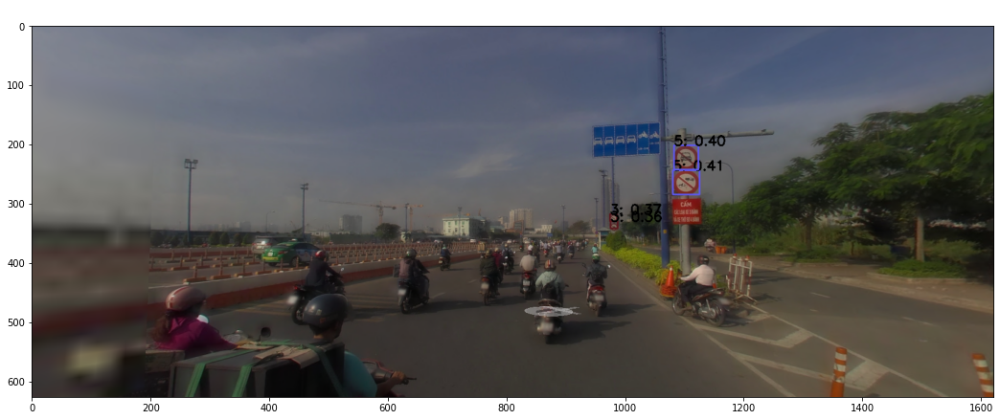

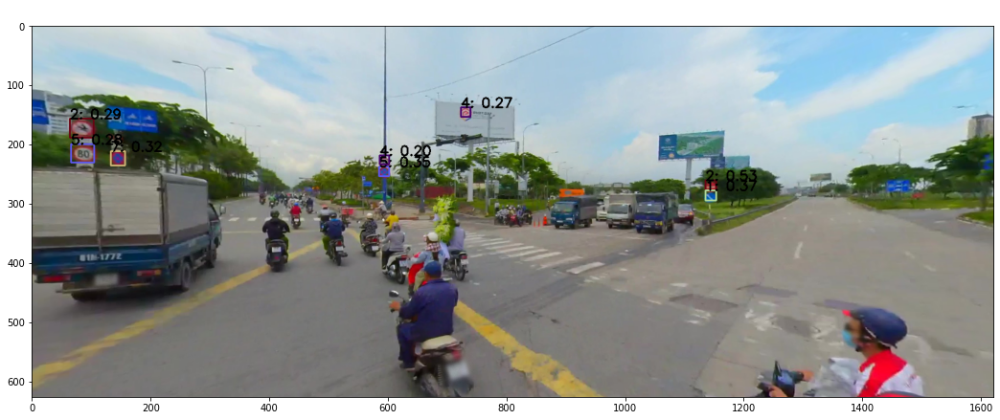

...

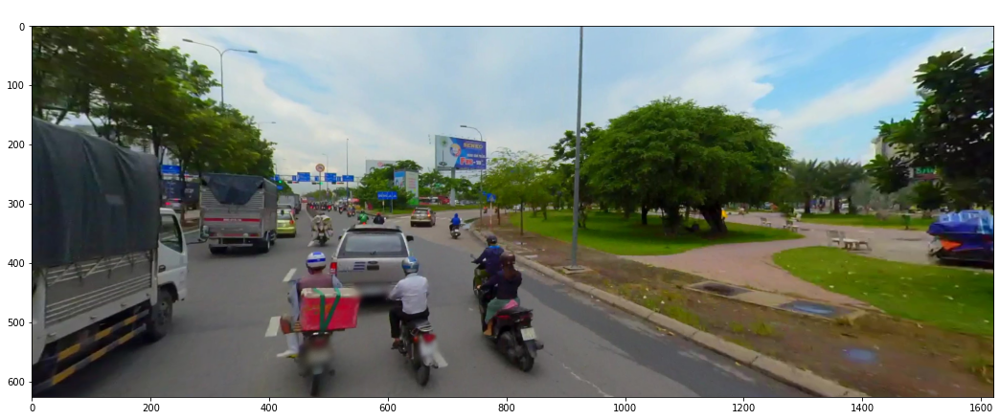

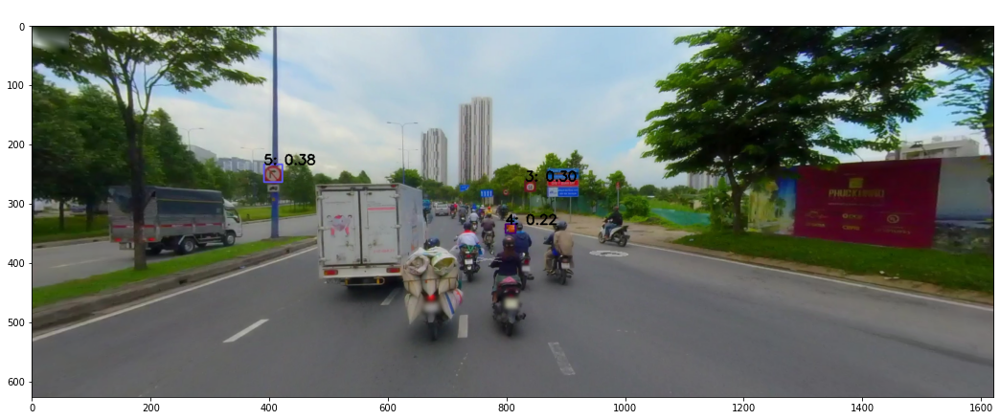

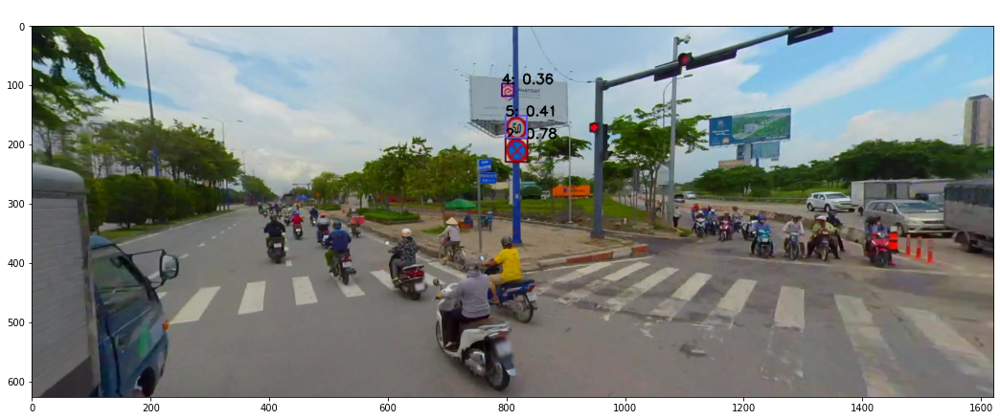

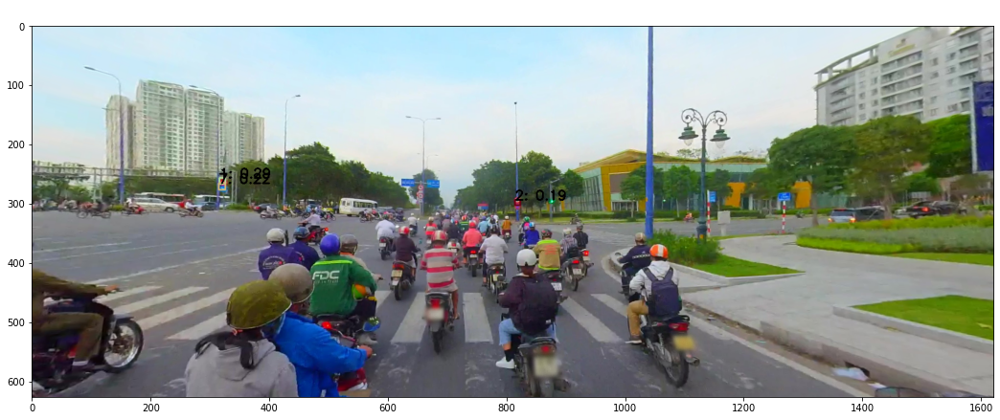

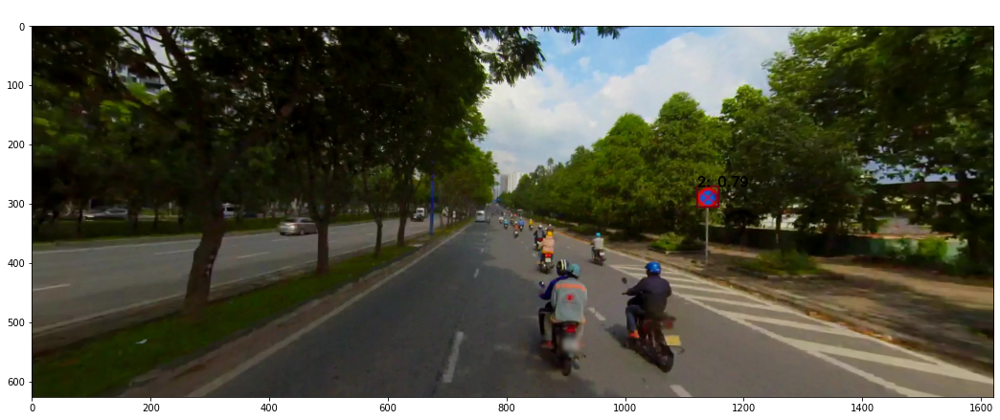

In [23]:
# predictions = read_json('submission.json')
display_output(test_df, predictions, TEST_IMAGE, is_random=False, num_image=20)